<a href="https://colab.research.google.com/github/hmsch/porcelan/blob/main/figure_notebooks/figures_3_S6_S7_S8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import torch
from ete3 import Tree
import gc
import gseapy
import seaborn as sns
import time

%cd porcelan/
from plotting import double_tree_plot, NAN_COLOR_VALUE, nice_colors, get_tsne
from scores import get_lac_for_all_genes, get_lac_for_all_subtrees_all_genes
from model import TreeGeneModel
from training import optimize_weights
from tree_util import get_tree_dists, augment_tree_with_weights, get_node_and_edge_data

data_path = './data'
results_path = './results'

/home/hschlueter/porcelan


# Gene and edge weight optimization

In [2]:
def load_data(name, seed, n_cells):
  tree_path = f'{data_path}/preprocessed/{name}_pruned.nwk'

  # load data
  with open(f'{data_path}/preprocessed/{name}_cells.txt') as f:
    labels_in_order = np.array(f.read().splitlines())

  cell_meta = pd.read_csv(f'{data_path}/preprocessed/{name}_cell_types.txt', header=None)
  cell_meta.columns = ['cell_type']
  cell_meta.index = labels_in_order
  cell_meta['tumor'] = pd.read_csv(f'{data_path}/preprocessed/{name}_tumors.txt', header=None).values

  expression = pd.read_csv(f'{data_path}/preprocessed/{name}_normalized_log_counts.txt')
  expression.index = labels_in_order

  # subsample
  if seed is not None:
    np.random.seed(seed)
    keep_cells = np.random.choice(labels_in_order, size=n_cells, replace=False)
    expression = expression.loc[keep_cells]
    cell_meta = cell_meta.loc[keep_cells]
    labels_in_order = keep_cells

    etree = Tree(tree_path, format=1, quoted_node_names=True)
    print('height before:', etree.get_farthest_leaf()[1])
    print('leaves before:', len(etree.get_leaves()))
    etree.prune(keep_cells.tolist())
    tree_path = f'{data_path}/preprocessed/{name}_pruned_{seed}.nwk'
    etree.write(format=1, outfile=tree_path, quoted_node_names=True)
    print('height after:', etree.get_farthest_leaf()[1])
    print('leaves after:', len(etree.get_leaves()))

  return tree_path, expression, cell_meta, labels_in_order


def reproduce_gw_ew_results(name, seed, n_cells):
  tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
  suffix = f'_sub_{seed}' if seed is not None else ''
  np.random.seed(12345)

  # compute scores before optimization
  tree_dists, _ = get_tree_dists(Tree(tree_path, format=1, quoted_node_names=True), labels_in_order)
  gene_scores = get_lac_for_all_genes(tree_dists, expression)
  gene_scores = gene_scores.sort_values('score', ascending=False)
  ordered_genes = gene_scores.index

  # compute subtree scores
  scores_subtree, scores_remaining = get_lac_for_all_subtrees_all_genes(
      tree_path, expression[ordered_genes], decay_factor=10, quoted_node_names=True,
      gene_group_size=100)

  gc.collect()
  torch.cuda.empty_cache()

  gene_scores.to_csv(f'{results_path}/{name}_scores{suffix}.csv')
  scores_subtree.to_csv(f'{results_path}/{name}_scores_subtree{suffix}.csv')
  scores_remaining.to_csv(f'{results_path}/{name}_scores_remaining{suffix}.csv')

  norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))
  use_genes = ordered_genes

  # optimize just edge weights
  model = TreeGeneModel(tree_path, labels_in_order=norm_expression.index, gene_dim=len(use_genes),
                        skip_tip_distance=-1, decay_factor=10, quoted_node_names=True, initial_weight=0.5)
  loss_fig = optimize_weights(model, norm_expression[use_genes].values, lr=1e-2, epochs=1000, device='cuda:2', gene_group_size=20)
  ew_df = pd.DataFrame(torch.exp(model.log_edge_weights.detach()).cpu().numpy(), index=model.edges_ends, columns=['weight'])
  ew_df = pd.concat([ew_df, pd.DataFrame(0.5 * np.ones((len(model.skip_edges_ends), 1)), index=model.skip_edges_ends, columns=['weight'])])
  loss_fig.show()
  ew_df.to_csv(f'{results_path}/{name}_ew{suffix}.csv')

  del model
  gc.collect()
  torch.cuda.empty_cache()

  # optimize both gene and edge weights
  model = TreeGeneModel(tree_path, labels_in_order=norm_expression.index, gene_dim=len(use_genes), learn_gene_weights=True,
                        skip_tip_distance=-1, decay_factor=10, quoted_node_names=True, initial_weight=0.5)
  loss_fig = optimize_weights(model, norm_expression[use_genes].values, lr=1e-2, epochs=1000, device='cuda:2', gene_group_size=10)
  ewg_df = pd.DataFrame(torch.exp(model.log_edge_weights.detach()).cpu().numpy(),
                      index=model.edges_ends, columns=['weight'])
  ewg_df = pd.concat([ewg_df, pd.DataFrame(0.5 * np.ones((len(model.skip_edges_ends), 1)), index=model.skip_edges_ends, columns=['weight'])])
  gw_df = pd.DataFrame(torch.nn.functional.softmax(model.log_gene_weights.detach(), dim=0).cpu().numpy(),
                      index=use_genes, columns=['weight'])
  loss_fig.show()
  ewg_df.to_csv(f'{results_path}/{name}_ewg{suffix}.csv')
  gw_df.to_csv(f'{results_path}/{name}_gw{suffix}.csv')

  del model
  gc.collect()
  torch.cuda.empty_cache()

## Tumor 3515_Lkb1_T1 and its metastases

With different sub-sampling random seeds.

### Seed 19442

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


epoch: 1000; score: 459.355084093297194; : 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.29it/s]


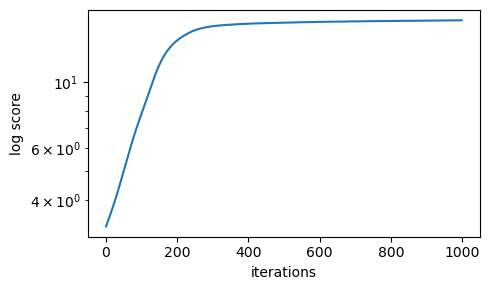

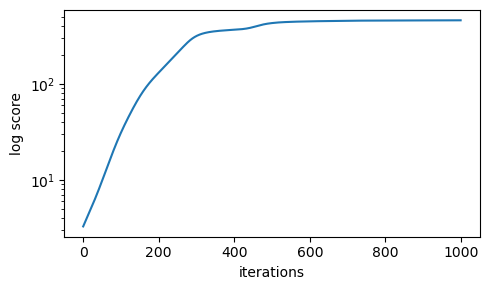

In [151]:
name = '3515_Lkb1_T1_Fam'
seed = 19442
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

### Seed 82712

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


epoch: 1000; score: 408.194678160564081; : 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.31it/s]


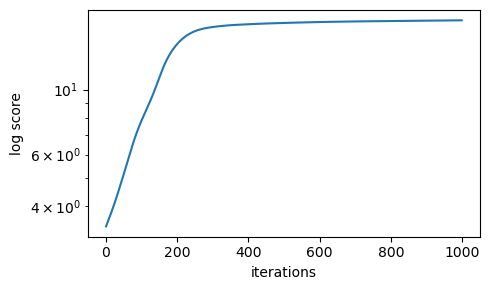

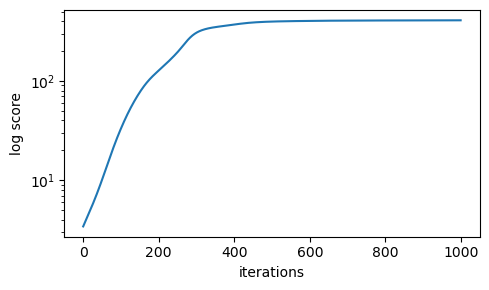

In [150]:
name = '3515_Lkb1_T1_Fam'
seed = 82712
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

### Seed 29873

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


epoch: 1000; score: 653.955066550915944; : 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.29it/s]


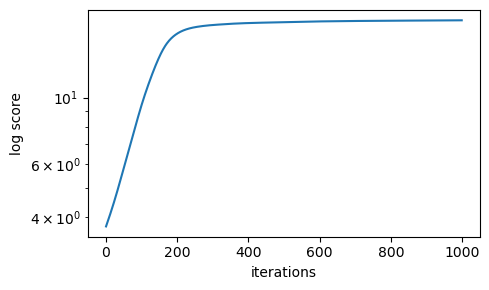

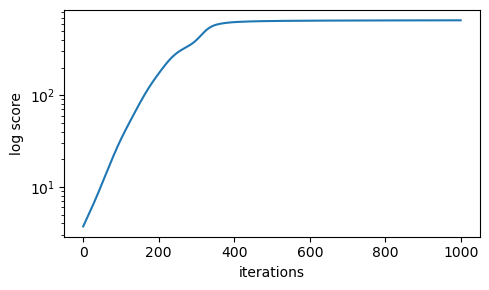

In [149]:
name = '3515_Lkb1_T1_Fam'
seed = 29873
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

### Seed 52382

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


epoch: 1000; score: 608.643265827622258; : 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.29it/s]


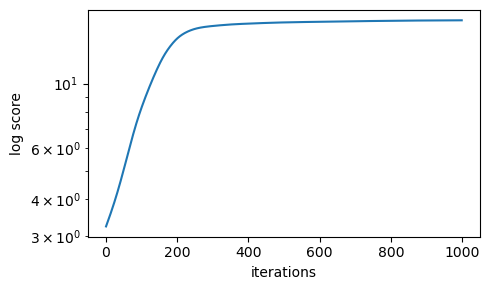

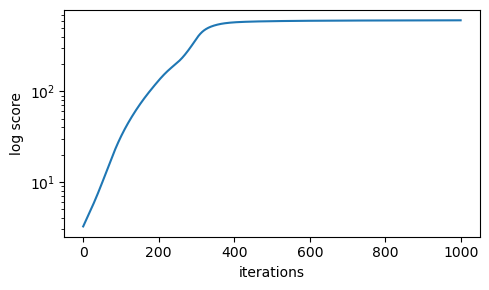

In [148]:
name = '3515_Lkb1_T1_Fam'
seed = 52382
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

### Seed 79815

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


epoch: 1000; score: 658.202600893236195; : 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.27it/s]


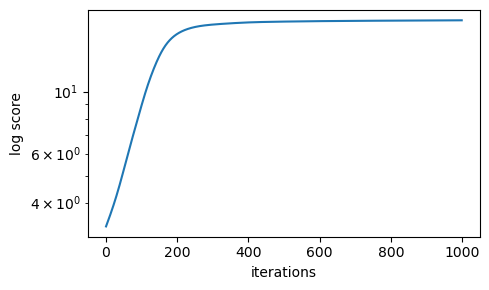

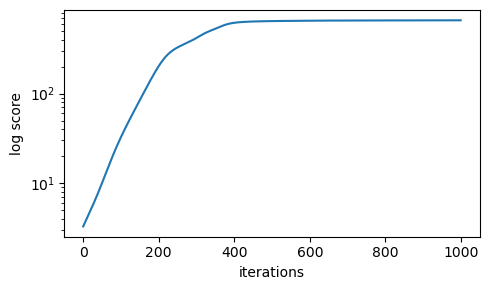

In [147]:
name = '3515_Lkb1_T1_Fam'
seed = 79815
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

## Tumor 3457_Apc_T1 and its metastases

epoch: 1000; score: 404.217844434098197; : 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [01:18<00:00, 12.78it/s]


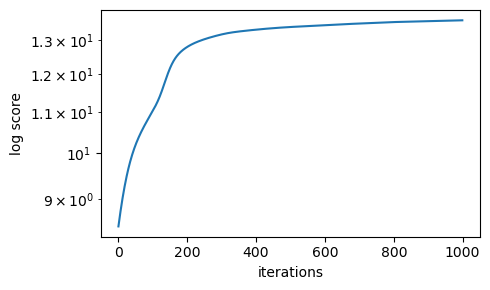

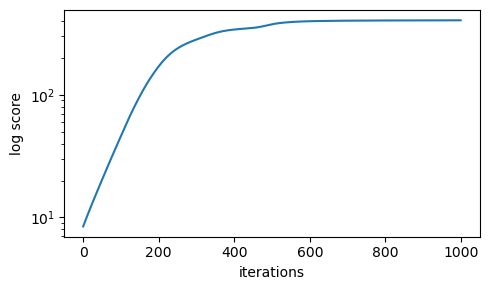

In [146]:
name = '3457_Apc_T1_Fam'

reproduce_gw_ew_results(name, seed=None, n_cells=None)

# Select genes and GO-term analysis

## Tumor 3515_Lkb1_T1 and its metastases

With different sub-sampling random seeds.

### Seed 19442 (used in Fig. 3)

In [152]:
name = '3515_Lkb1_T1_Fam'
seed = 19442
n_cells = 1000

# Rank comparison to select genes
ew_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,0,agree
Clu,1,-0.672344,0.672344,1,agree
Sftpb,2,0.532347,0.532347,2,agree
Krt19,3,-0.539653,0.539653,3,agree
Lyz2,4,0.678393,0.678393,4,agree
...,...,...,...,...,...
Adcy9,712,0.007191,0.007191,152,score <= 1.64
Dhrs11,713,-0.018061,0.018061,167,score <= 1.64
Gcnt1,714,0.008718,0.008718,161,score <= 1.64
Kbtbd4,715,-0.027724,0.027724,147,score <= 1.64


score unsignificant at\n5% significance level    479
selected                                         146
not selected but\nscore significant               92
Name: color, dtype: int64


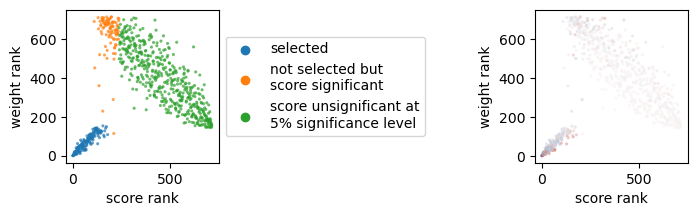

In [153]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [154]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000002,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000006,0.002002
2,Translation (GO:0006412),0.000059,0.018059
3,Peptide Biosynthetic Process (GO:0043043),0.000073,0.014151
4,Positive Regulation Of Peptidase Activity (GO:...,0.000212,0.014151
5,Gene Expression (GO:0010467),0.000360,0.012973
6,Negative Regulation Of Apoptotic Process (GO:0...,0.002022,0.114241
7,Tight Junction Assembly (GO:0120192),0.005905,0.211689
8,Apical Junction Assembly (GO:0043297),0.005905,0.217400
9,Epithelium Development (GO:0060429),0.016079,0.659353


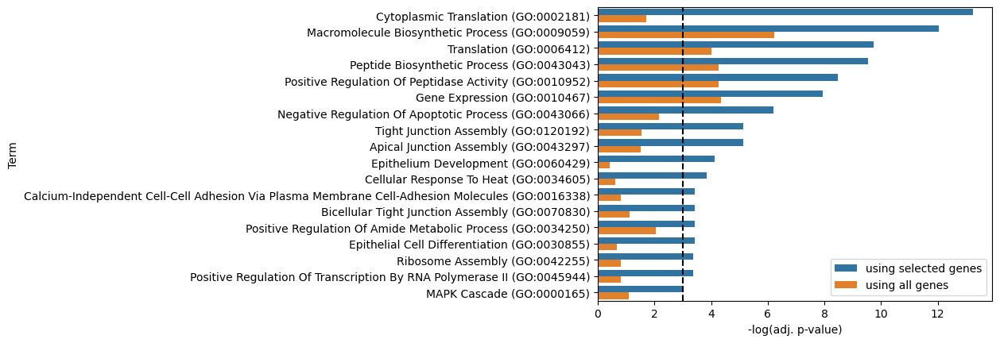

In [155]:
df = (-pd.read_csv(f'{results_path}/{name}_selected_genes_sub_{seed}.csv').rename(
    columns={'Adjusted P-value':'using selected genes', 'Adjusted P-value using all genes':'using all genes'}
).set_index('Term').apply(np.log)).reset_index()
mdf = pd.melt(df, id_vars=['Term'], value_vars=['using selected genes', 'using all genes'], value_name='-log(adj. p-value)')
sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable')
plt.gca().legend().set_title('')
plt.axvline(-np.log(0.05), color='k', ls='--')

### Seed 82712

In [156]:
name = '3515_Lkb1_T1_Fam'
seed = 82712
n_cells = 1000

# Rank comparison to select genes
ew_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,1,agree
Clu,1,-0.672344,0.672344,0,agree
Sftpb,2,0.532347,0.532347,3,agree
Krt19,3,-0.539653,0.539653,4,agree
Lyz2,4,0.678393,0.678393,5,agree
...,...,...,...,...,...
Zfp386,712,0.048480,0.048480,239,score <= 1.64
Plpp6,713,-0.033059,0.033059,138,score <= 1.64
Ephb6,714,-0.038351,0.038351,140,score <= 1.64
Kbtbd4,715,-0.027724,0.027724,136,score <= 1.64


score unsignificant at\n5% significance level    473
selected                                         134
not selected but\nscore significant              110
Name: color, dtype: int64


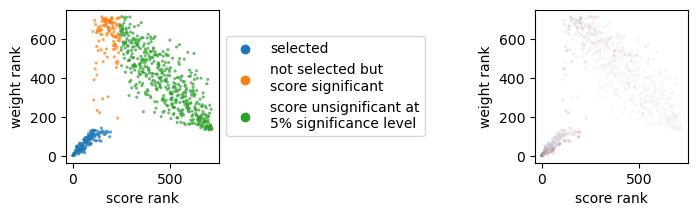

In [157]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [158]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),6.490503e-07,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),2.139675e-05,0.002002
2,Translation (GO:0006412),1.709174e-04,0.018059
3,Gene Expression (GO:0010467),1.851960e-04,0.012973
4,Peptide Biosynthetic Process (GO:0043043),2.378585e-04,0.014151
5,Positive Regulation Of Peptidase Activity (GO:...,3.115354e-03,0.014151
6,Negative Regulation Of Apoptotic Process (GO:0...,3.115354e-03,0.114241
7,Calcium-Independent Cell-Cell Adhesion Via Pla...,3.266529e-02,0.447485
8,Tight Junction Assembly (GO:0120192),4.619182e-02,0.211689
9,Apical Junction Assembly (GO:0043297),4.619182e-02,0.217400


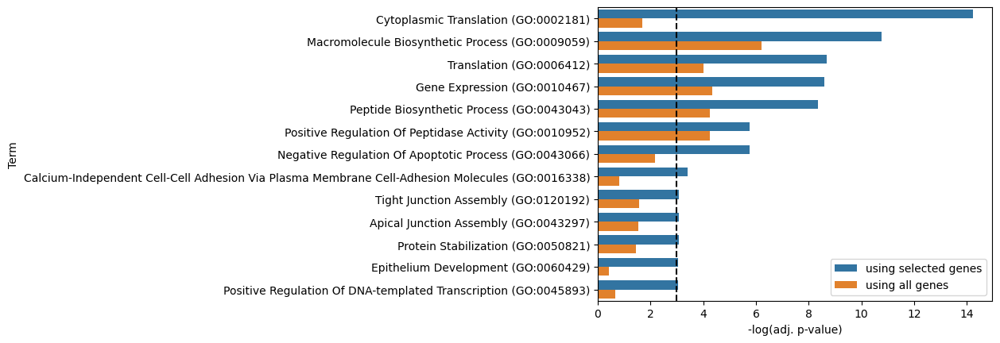

In [159]:
df = (-pd.read_csv(f'{results_path}/{name}_selected_genes_sub_{seed}.csv').rename(
    columns={'Adjusted P-value':'using selected genes', 'Adjusted P-value using all genes':'using all genes'}
).set_index('Term').apply(np.log)).reset_index()
mdf = pd.melt(df, id_vars=['Term'], value_vars=['using selected genes', 'using all genes'], value_name='-log(adj. p-value)')
sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable')
plt.gca().legend().set_title('')
plt.axvline(-np.log(0.05), color='k', ls='--')

### Seed 29873

In [160]:
name = '3515_Lkb1_T1_Fam'
seed = 29873
n_cells = 1000

# Rank comparison to select genes
ew_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 210) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,5,agree
Clu,1,-0.672344,0.672344,11,agree
Sftpb,2,0.532347,0.532347,14,agree
Krt19,3,-0.539653,0.539653,6,agree
Car2,4,-0.466837,0.466837,13,agree
...,...,...,...,...,...
4732490B19Rik,712,0.005164,0.005164,153,score <= 1.64
Chst9,713,-0.044848,0.044848,171,score <= 1.64
Il6,714,0.055977,0.055977,141,score <= 1.64
Nkx2-6,715,-0.047131,0.047131,174,score <= 1.64


score unsignificant at\n5% significance level    466
selected                                         143
not selected but\nscore significant              108
Name: color, dtype: int64


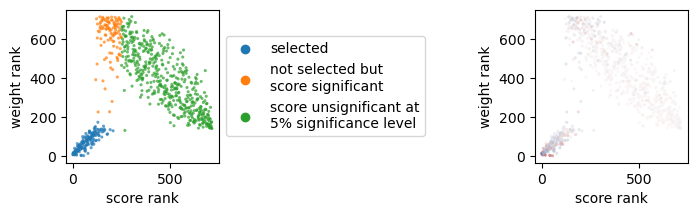

In [161]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [162]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Macromolecule Biosynthetic Process (GO:0009059),6.687970e-07,0.002002
1,Cytoplasmic Translation (GO:0002181),6.687970e-07,0.182657
2,Translation (GO:0006412),4.961410e-06,0.018059
3,Peptide Biosynthetic Process (GO:0043043),5.015736e-06,0.014151
4,Gene Expression (GO:0010467),6.185268e-06,0.012973
5,Positive Regulation Of Peptidase Activity (GO:...,5.076451e-03,0.014151
6,Positive Regulation Of Amide Metabolic Process...,5.101615e-03,0.127855
7,Protein Stabilization (GO:0050821),1.728202e-02,0.232433
8,Negative Regulation Of Apoptotic Process (GO:0...,2.200937e-02,0.114241
9,Positive Regulation Of Macromolecule Biosynthe...,2.659137e-02,0.366372


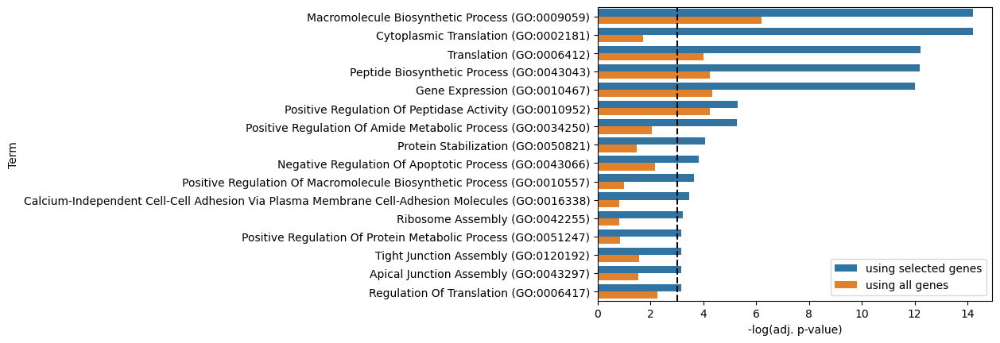

In [163]:
df = (-pd.read_csv(f'{results_path}/{name}_selected_genes_sub_{seed}.csv').rename(
    columns={'Adjusted P-value':'using selected genes', 'Adjusted P-value using all genes':'using all genes'}
).set_index('Term').apply(np.log)).reset_index()
mdf = pd.melt(df, id_vars=['Term'], value_vars=['using selected genes', 'using all genes'], value_name='-log(adj. p-value)')
sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable')
plt.gca().legend().set_title('')
plt.axvline(-np.log(0.05), color='k', ls='--')

### Seed 52382

In [164]:
name = '3515_Lkb1_T1_Fam'
seed = 52382
n_cells = 1000

# Rank comparison to select genes
ew_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,1,agree
Clu,1,-0.672344,0.672344,4,agree
Krt19,2,-0.539653,0.539653,3,agree
Sftpb,3,0.532347,0.532347,5,agree
Lyz2,4,0.678393,0.678393,6,agree
...,...,...,...,...,...
Wfs1,712,-0.086879,0.086879,172,score <= 1.64
M1ap,713,0.007992,0.007992,143,score <= 1.64
Armc5,714,-0.018211,0.018211,191,score <= 1.64
Ephb6,715,-0.038351,0.038351,176,score <= 1.64


score unsignificant at\n5% significance level    473
selected                                         144
not selected but\nscore significant              100
Name: color, dtype: int64


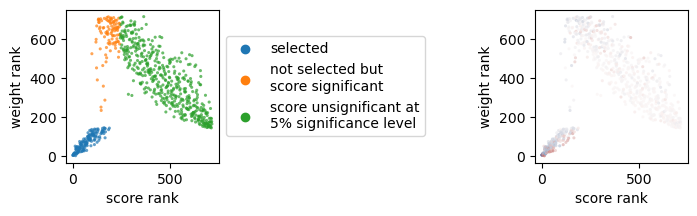

In [165]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [166]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000001,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000005,0.002002
2,Translation (GO:0006412),0.000048,0.018059
3,Peptide Biosynthetic Process (GO:0043043),0.000060,0.014151
4,Positive Regulation Of Peptidase Activity (GO:...,0.000187,0.014151
5,Gene Expression (GO:0010467),0.000293,0.012973
6,Tight Junction Assembly (GO:0120192),0.005218,0.211689
7,Positive Regulation Of Cellular Respiration (G...,0.005218,0.269699
8,Apical Junction Assembly (GO:0043297),0.005218,0.217400
9,Negative Regulation Of Apoptotic Process (GO:0...,0.021402,0.114241


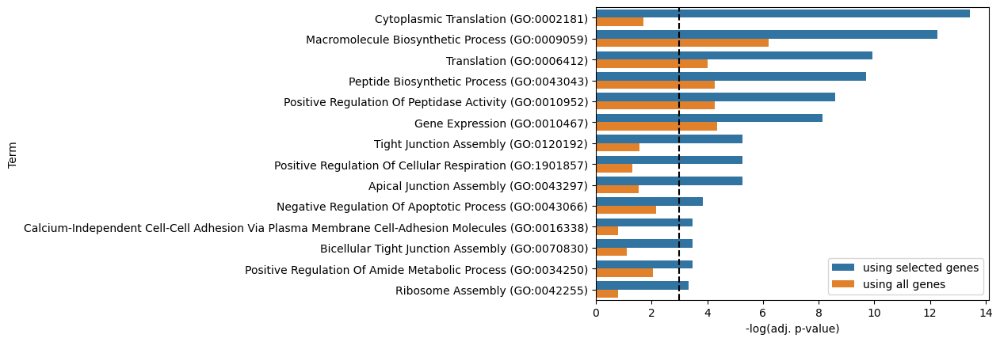

In [167]:
df = (-pd.read_csv(f'{results_path}/{name}_selected_genes_sub_{seed}.csv').rename(
    columns={'Adjusted P-value':'using selected genes', 'Adjusted P-value using all genes':'using all genes'}
).set_index('Term').apply(np.log)).reset_index()
mdf = pd.melt(df, id_vars=['Term'], value_vars=['using selected genes', 'using all genes'], value_name='-log(adj. p-value)')
sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable')
plt.gca().legend().set_title('')
plt.axvline(-np.log(0.05), color='k', ls='--')

### Seed 79815

In [168]:
name = '3515_Lkb1_T1_Fam'
seed = 79815
n_cells = 1000

# Rank comparison to select genes
ew_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,6,agree
Clu,1,-0.672344,0.672344,11,agree
Sftpb,2,0.532347,0.532347,9,agree
Krt19,3,-0.539653,0.539653,7,agree
Lyz2,4,0.678393,0.678393,8,agree
...,...,...,...,...,...
Arhgap40,712,-0.009414,0.009414,156,score <= 1.64
Rnmtl1,713,0.011094,0.011094,164,score <= 1.64
1810014B01Rik,714,-0.016915,0.016915,176,score <= 1.64
Gm26609,715,-0.038363,0.038363,152,score <= 1.64


score unsignificant at\n5% significance level    476
selected                                         150
not selected but\nscore significant               91
Name: color, dtype: int64


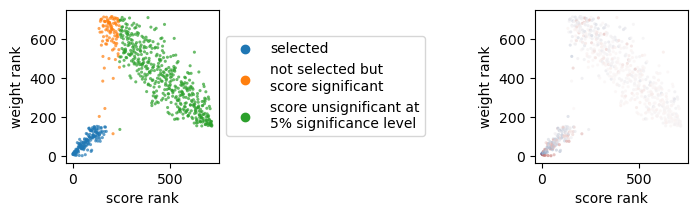

In [169]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [170]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000002,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000079,0.002002
2,Positive Regulation Of Peptidase Activity (GO:...,0.000399,0.014151
3,Translation (GO:0006412),0.000455,0.018059
4,Peptide Biosynthetic Process (GO:0043043),0.000702,0.014151
5,Gene Expression (GO:0010467),0.002851,0.012973
6,Protein Stabilization (GO:0050821),0.004589,0.232433
7,Positive Regulation Of Amide Metabolic Process...,0.005983,0.127855
8,Tight Junction Assembly (GO:0120192),0.005983,0.211689
9,Apical Junction Assembly (GO:0043297),0.005983,0.217400


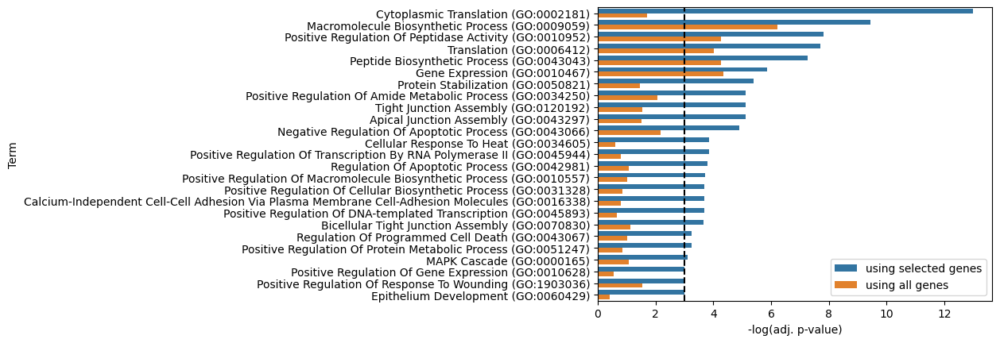

In [171]:
df = (-pd.read_csv(f'{results_path}/{name}_selected_genes_sub_{seed}.csv').rename(
    columns={'Adjusted P-value':'using selected genes', 'Adjusted P-value using all genes':'using all genes'}
).set_index('Term').apply(np.log)).reset_index()
mdf = pd.melt(df, id_vars=['Term'], value_vars=['using selected genes', 'using all genes'], value_name='-log(adj. p-value)')
sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable')
plt.gca().legend().set_title('')
plt.axvline(-np.log(0.05), color='k', ls='--')

## Tumor 3457_Apc_T1 and its metastases (used in S8)

In [23]:
name = '3457_Apc_T1_Fam'

# Rank comparison to select genes
ew_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_ew.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_ewg.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_gw.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_subtree.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'/home/hschlueter/results/kp-tracer/{name}_scores_remaining.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 150) & (gene_rank_df['weight rank'] < 150), 'color'] = 'agree'
gene_rank_df

,score rank,Scgb1a1 corr,Scgb1a1 abs corr,weight rank,color
Scgb1a1,0,NaN,NaN,7,agree
Epcam,1,0.346919,0.346919,0,agree
Krt7,2,0.540090,0.540090,5,agree
Stmn2,3,-0.330289,0.330289,1,agree
Cldn7,4,0.356227,0.356227,2,agree
...,...,...,...,...,...
Tab3,610,-0.002437,0.002437,103,score <= 1.64
A330017A19Rik,611,-0.016059,0.016059,104,score <= 1.64
Card19,612,-0.019740,0.019740,114,score <= 1.64
Ly75,613,0.011505,0.011505,105,score <= 1.64


score unsignificant at\n5% significance level    324
not selected but\nscore significant              192
selected                                          99
Name: color, dtype: int64


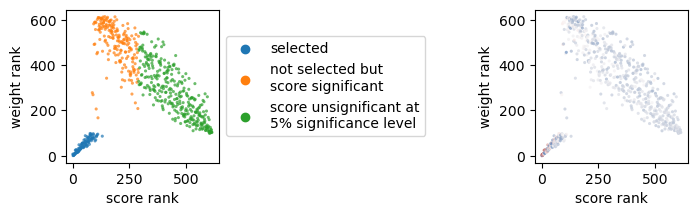

In [24]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/{name}_agree_genes.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [25]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/{name}_selected_genes.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Macromolecule Biosynthetic Process (GO:0009059),0.001103,0.000133
1,Tight Junction Assembly (GO:0120192),0.001103,0.250113
2,Positive Regulation Of Peptidase Activity (GO:...,0.001103,0.003978
3,Cytoplasmic Translation (GO:0002181),0.001103,0.081720
4,Translation (GO:0006412),0.002772,0.003073
5,Bicellular Tight Junction Assembly (GO:0070830),0.008061,0.323665
6,Regulation Of Cell Population Proliferation (G...,0.008061,0.140305
7,Calcium-Independent Cell-Cell Adhesion Via Pla...,0.008061,0.323665
8,Gene Expression (GO:0010467),0.008061,0.000672
9,Peptide Biosynthetic Process (GO:0043043),0.008716,0.003978


# Figure 3 and S7

## Seed 19442

In [180]:
name = '3515_Lkb1_T1_Fam'
seed = 19442
n_cells = 1000
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

gene_scores = pd.read_csv(f'{results_path}/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


In [181]:
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[np.concatenate([norm_expression[gene], NAN_COLOR_VALUE * np.ones(len(scores_subtree))]) for gene in show_genes] + [
                                         np.concatenate([NAN_COLOR_VALUE * np.ones(len(norm_expression)), scores_subtree[gene].clip(upper=10)]) for gene in show_genes] + [
                                         ewg_df.loc[node_labels, 'weight']],
                 color_names=[f'{gene} expression' for gene in show_genes] + [f'{gene} subtree score' for gene in show_genes] + ['incoming edge weight'],
                 tooltip_names=['cell_label', 'incoming edge weight'],
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [182]:
additional_color_domain = [
    '3515_Lkb1_T1',
    '3515_Lkb1_K2',
    '3515_Lkb1_K3',
    '3515_Lkb1_L2',
    '3515_Lkb1_N1',
    '3515_Lkb1_L1',
    '3515_Lkb1_K1',
]

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [183]:
ew_df = pd.read_csv(f'{results_path}/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

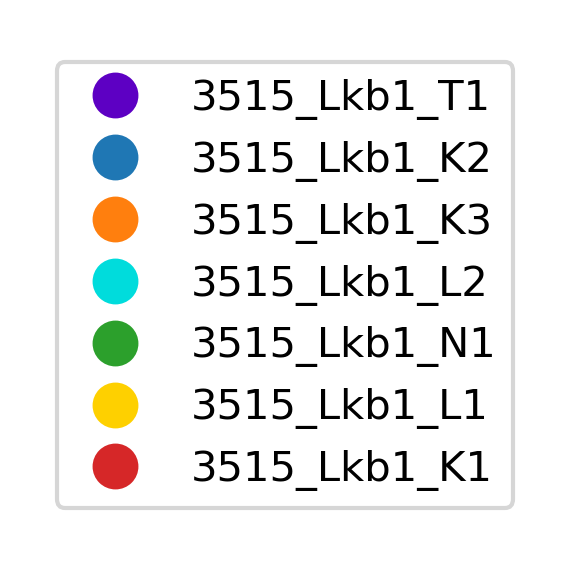

In [184]:
from matplotlib.lines import Line2D

color_df = pd.DataFrame(index=additional_color_domain)
color_df['color'] = nice_colors[1:len(additional_color_domain)+1]
legend_elements = []
for color, cell_type in zip(color_df['color'], color_df.index):
  legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

# Create the figure
fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis('off')
ax.legend(handles=legend_elements, loc='center', ncol=1)
fig.tight_layout()

/home/hschlueter/anaconda3/envs/myenv-38/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/hschlueter/anaconda3/envs/myenv-38/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


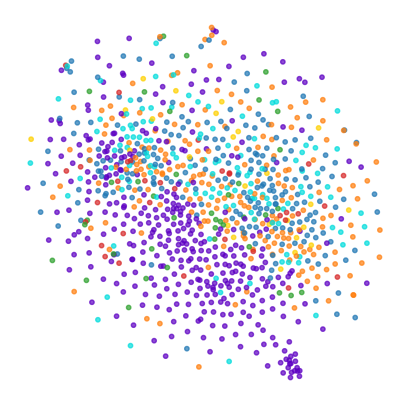

In [185]:
points = get_tsne(norm_expression)

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
color_df = pd.DataFrame(index=additional_color_domain)
color_df['color'] = nice_colors[1:len(additional_color_domain)+1]
ax.scatter(points[:, 0], points[:, 1],
           c=color_df.loc[cell_meta.loc[norm_expression.index]['tumor']].values.flatten(),
           alpha=0.7, s=10)
ax.axis('off')
fig.show()

In [186]:
seeds = [82712, 29873, 52382, 19442, 79815]
all_genes = expression.columns.to_list()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
print(repr(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values))
enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]

df = enr_all.results[['Term', 'Adjusted P-value']].copy().set_index('Term').rename(columns={'Adjusted P-value':'Adjusted P-value using all expressed genes'})
for seed in seeds:
  time.sleep(1)  # because many fast API calls are not allowed
  sel_genes = pd.read_csv(f'{results_path}/{name}_agree_genes_sub_{seed}.txt', header=None).values.flatten().tolist()
  enr_sel = gseapy.enrichr(gene_list=sel_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
  df = df.merge(enr_sel.results.set_index('Term')[['Adjusted P-value']].rename(
      columns={'Adjusted P-value':f'Adjusted P-value using selected genes ({seed})'}), left_index=True, right_index=True)
df['Avg. adjusted P-value using selected genes'] =  df[df.columns[1:]].mean(axis=1)
df = df.sort_values('Avg. adjusted P-value using selected genes')
df = df[df.columns[1:].tolist() + [df.columns[0]]]
df.to_csv(f'{results_path}/{name}_selected_genes_sub.csv')
df

array(['Macromolecule Biosynthetic Process (GO:0009059)',
       'Gene Expression (GO:0010467)',
       'Peptide Biosynthetic Process (GO:0043043)',
       'Positive Regulation Of Peptidase Activity (GO:0010952)',
       'RNA Processing (GO:0006396)', 'Translation (GO:0006412)',
       'Growth Hormone Receptor Signaling Pathway Via JAK-STAT (GO:0060397)',
       'Formation Of Cytoplasmic Translation Initiation Complex (GO:0001732)'],
      dtype=object)


,Adjusted P-value using selected genes (82712),Adjusted P-value using selected genes (29873),Adjusted P-value using selected genes (52382),Adjusted P-value using selected genes (19442),Adjusted P-value using selected genes (79815),Avg. adjusted P-value using selected genes,Adjusted P-value using all expressed genes
Term,,,,,,,
Cytoplasmic Translation (GO:0002181),6.490503e-07,6.687970e-07,0.000001,0.000002,0.000002,0.000001,0.182657
Macromolecule Biosynthetic Process (GO:0009059),2.139675e-05,6.687970e-07,0.000005,0.000006,0.000079,0.000022,0.002002
Translation (GO:0006412),1.709174e-04,4.961410e-06,0.000048,0.000059,0.000455,0.000148,0.018059
Peptide Biosynthetic Process (GO:0043043),2.378585e-04,5.015736e-06,0.000060,0.000073,0.000702,0.000216,0.014151
Gene Expression (GO:0010467),1.851960e-04,6.185268e-06,0.000293,0.000360,0.002851,0.000739,0.012973
...,...,...,...,...,...,...,...
Positive Regulation Of Cell Differentiation (GO:0045597),8.571342e-01,8.746970e-01,0.877307,0.879136,0.886108,0.874876,0.864839
Protein Modification Process (GO:0036211),9.923007e-01,9.650136e-01,0.966066,0.779636,0.908012,0.922206,0.794532
Organelle Organization (GO:0006996),9.444191e-01,9.543947e-01,0.955382,0.956379,0.830800,0.928275,0.788148


/tmp/ipykernel_902088/2953215175.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Term'].loc[9] = 'Calcium-Independent Cell-Cell Adhesion Via ... (GO:0016338)'


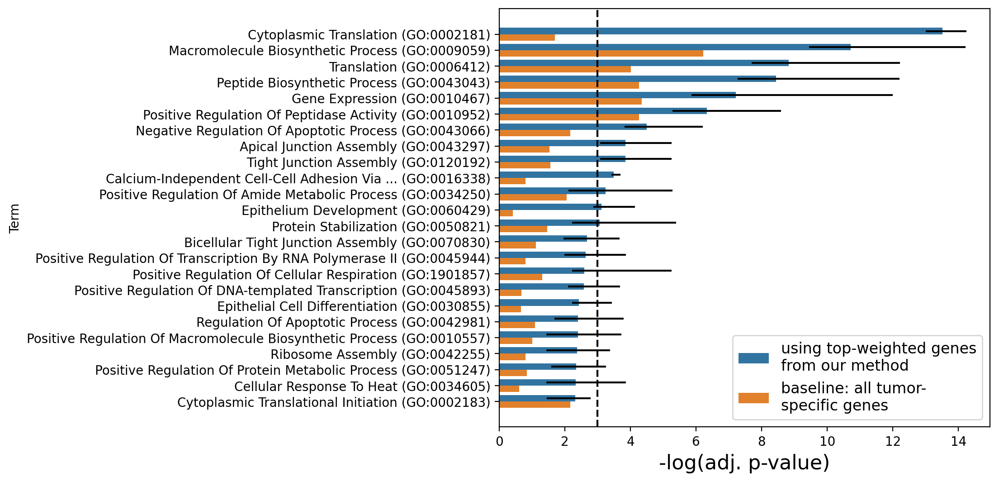

In [187]:
df = pd.read_csv(f'{results_path}/{name}_selected_genes_sub.csv')
assert df['Term'].loc[9] == 'Calcium-Independent Cell-Cell Adhesion Via Plasma Membrane Cell-Adhesion Molecules (GO:0016338)'
df['Term'].loc[9] = 'Calcium-Independent Cell-Cell Adhesion Via ... (GO:0016338)'
df = df.set_index('Term')
df.columns = df.columns.map(lambda x: x.split('using')[1][1:])
df = df[df['selected genes'] <= 0.1]

mdf = pd.melt((-df.apply(np.log)).reset_index(), id_vars=['Term'], value_vars=['selected genes', 'all expressed genes'], value_name='-log(adj. p-value)')
mdf.loc[0:len(df)-1, 'low'] = mdf['-log(adj. p-value)']
mdf.loc[0:len(df)-1, 'up'] = -mdf['-log(adj. p-value)']
mdf.loc[0:len(df)-1, 'low'] -= (-df[df.columns[:5]].max(axis=1).apply(np.log)).values
mdf.loc[0:len(df)-1, 'up'] += (-df[df.columns[:5]].min(axis=1).apply(np.log)).values
mdf.variable = mdf.variable.replace({'selected genes':'using top-weighted genes\nfrom our method',
                                     'all expressed genes':'baseline: all tumor-\nspecific genes'})

fig, ax = plt.subplots(dpi=200, figsize=(7, 6))
ax = sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable', ax=ax)

x_coords = [p.get_width() for p in ax.patches]
y_coords = [p.get_y() + 0.5 * p.get_height() for p in ax.patches]
ax.errorbar(x=x_coords, y=y_coords, xerr=mdf[['low', 'up']].values.T, fmt="none", c="k")

plt.gca().legend(fontsize=12).set_title('')
ax.set_xlabel('-log(adj. p-value)', fontsize=16)
plt.axvline(-np.log(0.05), color='k', ls='--')

# Figure S6

/tmp/ipykernel_902088/1576420261.py:21: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  fig.tight_layout()


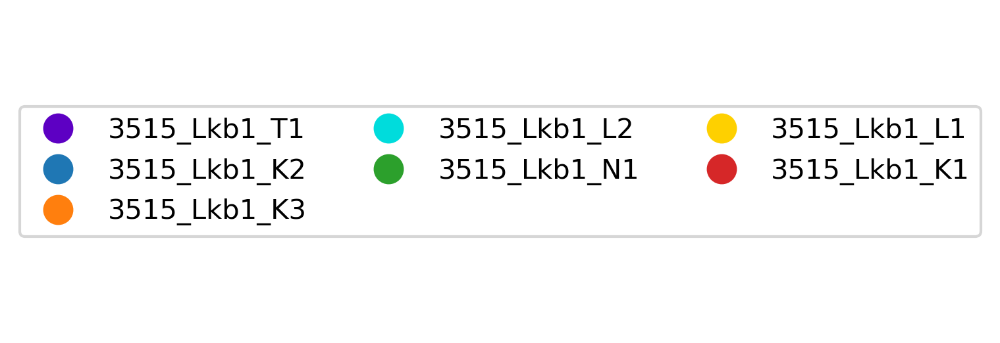

In [110]:
from matplotlib.lines import Line2D

additional_color_domain = [
    '3515_Lkb1_T1',
    '3515_Lkb1_K2',
    '3515_Lkb1_K3',
    '3515_Lkb1_L2',
    '3515_Lkb1_N1',
    '3515_Lkb1_L1',
    '3515_Lkb1_K1',
]

legend_elements = []
for color, cell_type in zip(color_df['color'], color_df.index):
  legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

# Create the figure
fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis('off')
ax.legend(handles=legend_elements, loc='center', ncol=3)
fig.tight_layout()

### Seed 82712

In [114]:
name = '3515_Lkb1_T1_Fam'
seed = 82712
n_cells = 1000
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

gene_scores = pd.read_csv(f'{results_path}/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


In [115]:
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[np.concatenate([norm_expression[gene], NAN_COLOR_VALUE * np.ones(len(scores_subtree))]) for gene in show_genes] + [
                                         np.concatenate([NAN_COLOR_VALUE * np.ones(len(norm_expression)), scores_subtree[gene].clip(upper=10)]) for gene in show_genes] + [
                                         ewg_df.loc[node_labels, 'weight']],
                 color_names=[f'{gene} expression' for gene in show_genes] + [f'{gene} subtree score' for gene in show_genes] + ['incoming edge weight'],
                 tooltip_names=['cell_label', 'incoming edge weight'],
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [116]:
double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [118]:
ew_df = pd.read_csv(f'{results_path}/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

### Seed 29873

In [119]:
name = '3515_Lkb1_T1_Fam'
seed = 29873
n_cells = 1000
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

gene_scores = pd.read_csv(f'{results_path}/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


In [120]:
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[np.concatenate([norm_expression[gene], NAN_COLOR_VALUE * np.ones(len(scores_subtree))]) for gene in show_genes] + [
                                         np.concatenate([NAN_COLOR_VALUE * np.ones(len(norm_expression)), scores_subtree[gene].clip(upper=10)]) for gene in show_genes] + [
                                         ewg_df.loc[node_labels, 'weight']],
                 color_names=[f'{gene} expression' for gene in show_genes] + [f'{gene} subtree score' for gene in show_genes] + ['incoming edge weight'],
                 tooltip_names=['cell_label', 'incoming edge weight'],
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [121]:
double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [122]:
ew_df = pd.read_csv(f'{results_path}/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

### Seed 52382

In [123]:
name = '3515_Lkb1_T1_Fam'
seed = 52382
n_cells = 1000
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

gene_scores = pd.read_csv(f'{results_path}/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


In [124]:
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[np.concatenate([norm_expression[gene], NAN_COLOR_VALUE * np.ones(len(scores_subtree))]) for gene in show_genes] + [
                                         np.concatenate([NAN_COLOR_VALUE * np.ones(len(norm_expression)), scores_subtree[gene].clip(upper=10)]) for gene in show_genes] + [
                                         ewg_df.loc[node_labels, 'weight']],
                 color_names=[f'{gene} expression' for gene in show_genes] + [f'{gene} subtree score' for gene in show_genes] + ['incoming edge weight'],
                 tooltip_names=['cell_label', 'incoming edge weight'],
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [125]:
double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [126]:
ew_df = pd.read_csv(f'{results_path}/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

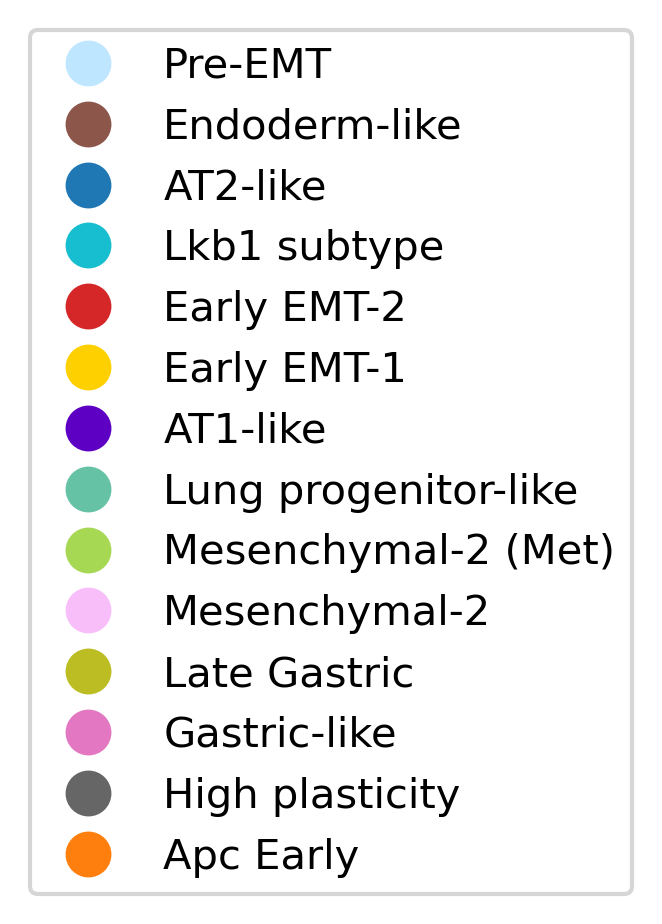

In [132]:
from matplotlib.lines import Line2D
from plotting import nice_colors, kp_color_domain

color_df = pd.DataFrame(index=kp_color_domain)
color_df['color'] = nice_colors
color_df = color_df.loc[cell_meta['cell_type'].value_counts().index]
legend_elements = []
for color, cell_type in zip(color_df['color'], color_df.index):
  legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

# Create the figure
fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis('off')
ax.legend(handles=legend_elements, loc='center', ncol=1)
fig.tight_layout()

### Seed 79815

In [127]:
name = '3515_Lkb1_T1_Fam'
seed = 79815
n_cells = 1000
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

gene_scores = pd.read_csv(f'{results_path}/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


In [128]:
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[np.concatenate([norm_expression[gene], NAN_COLOR_VALUE * np.ones(len(scores_subtree))]) for gene in show_genes] + [
                                         np.concatenate([NAN_COLOR_VALUE * np.ones(len(norm_expression)), scores_subtree[gene].clip(upper=10)]) for gene in show_genes] + [
                                         ewg_df.loc[node_labels, 'weight']],
                 color_names=[f'{gene} expression' for gene in show_genes] + [f'{gene} subtree score' for gene in show_genes] + ['incoming edge weight'],
                 tooltip_names=['cell_label', 'incoming edge weight'],
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [129]:
double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [130]:
ew_df = pd.read_csv(f'{results_path}/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

# Figure S8

In [3]:
name = '3457_Apc_T1_Fam'
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed=None, n_cells=None)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

additional_color_domain = [
    '3457_Apc_T1',
    '3457_Apc_K1',
    '3457_Apc_N2'
]

/tmp/ipykernel_932769/254589694.py:13: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  fig.tight_layout()


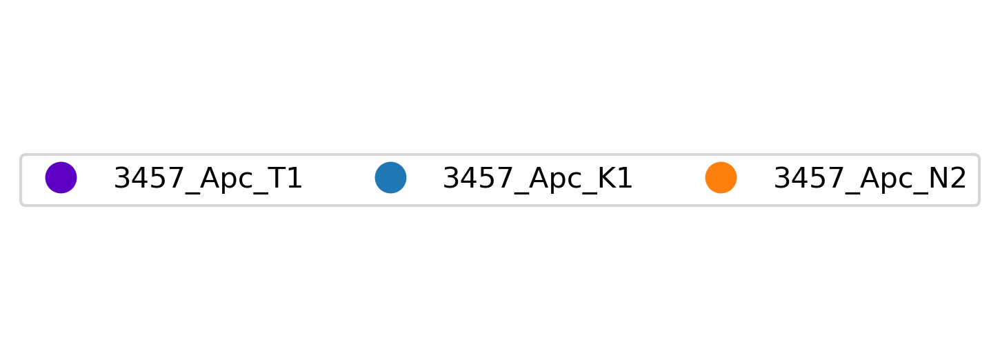

In [4]:
from matplotlib.lines import Line2D

color_df = pd.DataFrame(index=additional_color_domain)
color_df['color'] = nice_colors[1:len(additional_color_domain)+1]
legend_elements = []
for color, cell_type in zip(color_df['color'], color_df.index):
  legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

# Create the figure
fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis('off')
ax.legend(handles=legend_elements, loc='center', ncol=3)
fig.tight_layout()

/home/hschlueter/anaconda3/envs/myenv-38/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/hschlueter/anaconda3/envs/myenv-38/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


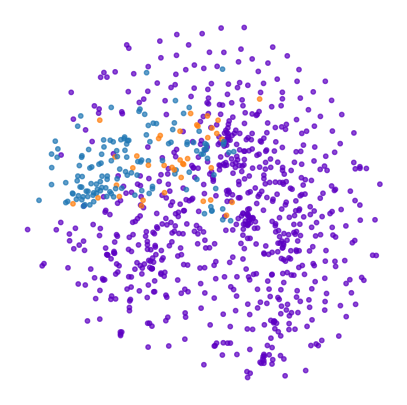

In [5]:
tsne_points = get_tsne(norm_expression)

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
color_df = pd.DataFrame(index=additional_color_domain)
color_df['color'] = nice_colors[1:len(additional_color_domain)+1]
ax.scatter(tsne_points[:, 0], tsne_points[:, 1],
           c=color_df.loc[cell_meta.loc[norm_expression.index]['tumor']].values.flatten(),
           alpha=0.7, s=10)
ax.axis('off')
fig.show()

/tmp/ipykernel_932769/301157115.py:15: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  fig.tight_layout()


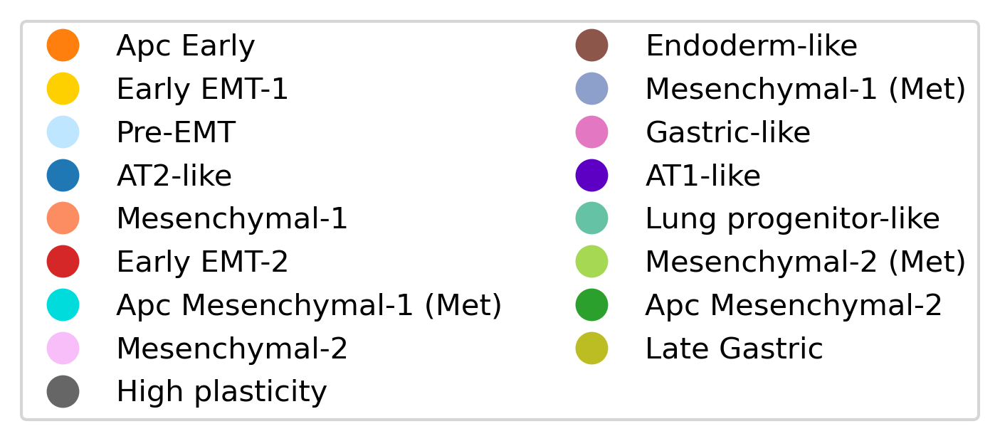

In [6]:
from matplotlib.lines import Line2D
from plotting import nice_colors, kp_color_domain

color_df = pd.DataFrame(index=kp_color_domain)
color_df['color'] = nice_colors
color_df = color_df.loc[cell_meta['cell_type'].value_counts().index]
legend_elements = []
for color, cell_type in zip(color_df['color'], color_df.index):
  legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

# Create the figure
fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis('off')
ax.legend(handles=legend_elements, loc='center', ncol=2)
fig.tight_layout()

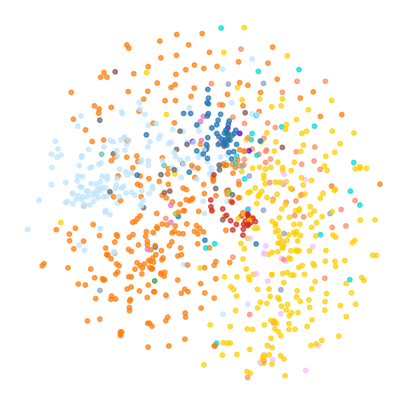

In [7]:
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.scatter(tsne_points[:, 0], tsne_points[:, 1],
           c=color_df.loc[cell_meta.loc[norm_expression.index]['cell_type']].values.flatten(),
           alpha=0.7, s=10)
ax.axis('off')
fig.show()

In [8]:
gene_scores = pd.read_csv(f'{results_path}/{name}_scores.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/{name}_scores_subtree.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/{name}_scores_remaining.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/{name}_ewg.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/{name}_gw.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

In [9]:
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[np.concatenate([norm_expression[gene], NAN_COLOR_VALUE * np.ones(len(scores_subtree))]) for gene in show_genes] + [
                                         np.concatenate([NAN_COLOR_VALUE * np.ones(len(norm_expression)), scores_subtree[gene].clip(upper=10)]) for gene in show_genes] + [
                                         ewg_df.loc[node_labels, 'weight']],
                 color_names=[f'{gene} expression' for gene in show_genes] + [f'{gene} subtree score' for gene in show_genes] + ['incoming edge weight'],
                 tooltip_names=['cell_label', 'incoming edge weight'],
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [10]:
double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [11]:
ew_df = pd.read_csv(f'{results_path}/{name}_ew.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

/tmp/ipykernel_932769/2282639189.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Term'].loc[7] = 'Calcium-Independent Cell-Cell Adhesion Via Plasma Membrane\nCell-Adhesion Molecules (GO:0016338)'


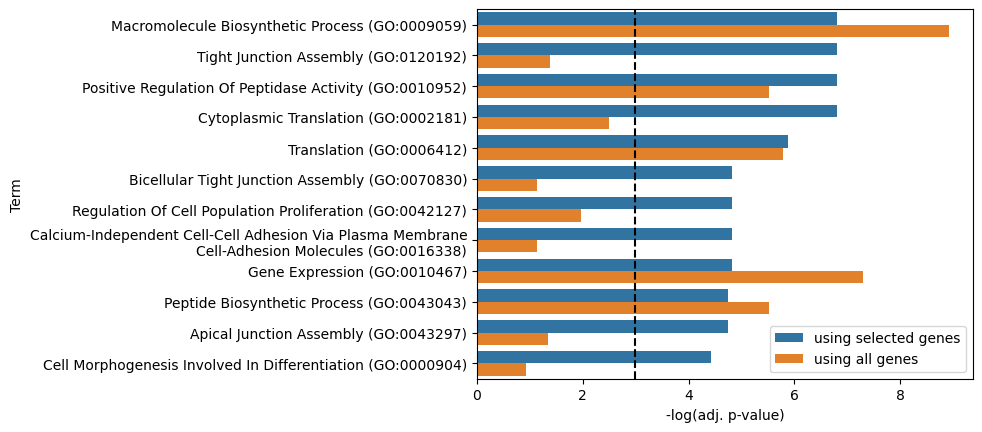

In [30]:
df = (-pd.read_csv(f'{results_path}/{name}_selected_genes.csv').rename(
    columns={'Adjusted P-value':'using selected genes', 'Adjusted P-value using all genes':'using all genes'}
).set_index('Term').apply(np.log)).reset_index()

assert df['Term'].loc[7] == 'Calcium-Independent Cell-Cell Adhesion Via Plasma Membrane Cell-Adhesion Molecules (GO:0016338)'
df['Term'].loc[7] = 'Calcium-Independent Cell-Cell Adhesion Via Plasma Membrane\nCell-Adhesion Molecules (GO:0016338)'

df = df.sort_values('using selected genes', ascending=False)

mdf = pd.melt(df, id_vars=['Term'], value_vars=['using selected genes', 'using all genes'], value_name='-log(adj. p-value)')
sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable')
plt.gca().legend().set_title('')
plt.axvline(-np.log(0.05), color='k', ls='--')